# Plotting Maps with Folium

### MODULES & LIBRARIES

In [1]:
# IMPORT MODULES

# Base -----------------------------------------------------------
import numpy as np
import pandas as pd
from scipy.stats import norm
from datetime import datetime
#import pandas_profiling

# Viz ------------------------------------------------------------
import matplotlib.pyplot as plt
import seaborn as sns
import plotnine
from plotnine import *
#import patchworklib as pw

In [2]:
from plotnine import *
import pandas as pd
import numpy as np

In [3]:
!pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 45.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.4/16.4 MB 81.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.7/7.7 MB 85.6 MB/s eta 0:00:00


In [4]:
import geopandas as gpd
import folium

In [5]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Loading BMUs info

In [6]:
#filepath = '/content/GD_Fede/MyDrive/IE - DS Boot/_Project/Data/Research/BM Units (historical info)/bmusid_21_23 (COMPLETE).xlsx'
#filepath = 'C:/Users/FAL/Desktop/QEnergy/Data/Research/BM Units (historical info)/bmusid_21_23 (COMPLETE).xlsx'
file_path = '/content/drive/MyDrive/QEnergy/Data/Research/BM Units (historical info)/bmusid_21_23 (COMPLETE).xlsx'

In [7]:
bmusid_21_23 = pd.read_excel(file_path)
bmusid_21_23

,BMU Type,NR,BMU ID,BMU Name,BMU Name Comment,BMU Fuel Type,BMU Fuel Type Comment,BMU Party ID Comment,BMU Party Name Comment,BMU GSP Group Id,BMU GSP Group Name,LOC LAT,LOC LONG,GSP LOC Center,LOC Center LAT,LOC Center LONG,Boundaries Zone
0,E,26,E_GYAR-1,Great Yarmouth Power Limited,Great Yarmouth,CCGT,CCGT,INNOGY01,RWE Generation UK plc,_A,Eastern England,52.583834,1.733725,Dalham,52.226649,0.519993,NaN
1,E,31,E_KLYN-A-1,Kings Lynn A,Kings Lynn,CCGT,CCGT,INNOGY01,RWE Generation UK plc,_A,Eastern England,52.727436,0.380419,Dalham,52.226649,0.519993,NaN
2,E,34,E_PETEM1,Peterborough,NaN,OCGT,CCGT,CENPB,River Nene Power Limited,_A,Eastern England,52.576835,-0.204150,Dalham,52.226649,0.519993,NaN
3,T,92,T_COSO-1,Coryton Power Station,Coryton,CCGT,CCGT,CECL,Coryton Energy Company Ltd,_A,Eastern England,51.512797,0.505550,Dalham,52.226649,0.519993,NaN
4,T,199,T_LBAR-1,Little Barford main unit 1,Little Barford,CCGT,CCGT,INNOGY01,RWE Generation UK plc,_A,Eastern England,52.203604,-0.269046,Dalham,52.226649,0.519993,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
452,T,6551,T_MOWEO-3,Moray East OWF3,Moray East 3 Offshore,WIND,Wind,MOWEL,Moray Offshore Wind East Ltd,_P,Northern Scotland,58.077384,-3.121303,Kingussie,57.229009,-4.078819,NaN
453,T,6552,T_MOWEO-1,Moray East OWF1,Moray East 1 Offshore,WIND,Wind,MOWEL,Moray Offshore Wind East Ltd,_P,Northern Scotland,58.077384,-3.121303,Kingussie,57.229009,-4.078819,NaN
454,2,6753,2__PEDGE003,2__PEDGE003,Camster B Wind,WIND,Wind,EDGWARE,Edgware Energy Limited,_P,Northern Scotland,58.357068,-3.254377,Kingussie,57.229009,-4.078819,NaN
455,2,6754,2__PEDGE004,2__PEDGE004,Rosehall Wind,WIND,Wind,EDGWARE,Edgware Energy Limited,_P,Northern Scotland,57.981817,-4.498357,Kingussie,57.229009,-4.078819,NaN


In [8]:
bmusid_21_23.isnull().sum()

BMU Type                    0
NR                          0
BMU ID                      0
BMU Name                    0
BMU Name Comment           17
BMU Fuel Type               0
BMU Fuel Type Comment       5
BMU Party ID Comment        0
BMU Party Name Comment      0
BMU GSP Group Id            0
BMU GSP Group Name          0
LOC LAT                     0
LOC LONG                    0
GSP LOC Center              0
LOC Center LAT              0
LOC Center LONG             0
Boundaries Zone           457
dtype: int64

In [9]:
bmusid_21_23.columns

Index(['BMU Type', 'NR', 'BMU ID', 'BMU Name', 'BMU Name Comment',
       'BMU Fuel Type', 'BMU Fuel Type Comment', 'BMU Party ID Comment',
       'BMU Party Name Comment', 'BMU GSP Group Id', 'BMU GSP Group Name',
       'LOC LAT', 'LOC LONG', 'GSP LOC Center', 'LOC Center LAT',
       'LOC Center LONG', 'Boundaries Zone'],
      dtype='object')

In [10]:
selected_cols = ['BMU ID', 'BMU Name', 'BMU Fuel Type', 'BMU Party ID Comment', 
                 'BMU GSP Group Name', 'LOC LAT', 'LOC LONG']

In [11]:
bmusid_21_23 = bmusid_21_23[selected_cols]
bmusid_21_23

,BMU ID,BMU Name,BMU Fuel Type,BMU Party ID Comment,BMU GSP Group Name,LOC LAT,LOC LONG
0,E_GYAR-1,Great Yarmouth Power Limited,CCGT,INNOGY01,Eastern England,52.583834,1.733725
1,E_KLYN-A-1,Kings Lynn A,CCGT,INNOGY01,Eastern England,52.727436,0.380419
2,E_PETEM1,Peterborough,OCGT,CENPB,Eastern England,52.576835,-0.204150
3,T_COSO-1,Coryton Power Station,CCGT,CECL,Eastern England,51.512797,0.505550
4,T_LBAR-1,Little Barford main unit 1,CCGT,INNOGY01,Eastern England,52.203604,-0.269046
...,...,...,...,...,...,...,...
452,T_MOWEO-3,Moray East OWF3,WIND,MOWEL,Northern Scotland,58.077384,-3.121303
453,T_MOWEO-1,Moray East OWF1,WIND,MOWEL,Northern Scotland,58.077384,-3.121303
454,2__PEDGE003,2__PEDGE003,WIND,EDGWARE,Northern Scotland,58.357068,-3.254377
455,2__PEDGE004,2__PEDGE004,WIND,EDGWARE,Northern Scotland,57.981817,-4.498357


### Preparing BMUs 21-23 map

http://www.movable-type.co.uk/scripts/latlong.html

In [12]:
file_path = '/content/drive/MyDrive/QEnergy/Data/Research/Maps/dno_license_areas_20200506/DNO_License_Areas_20200506.shp'

<Axes: >

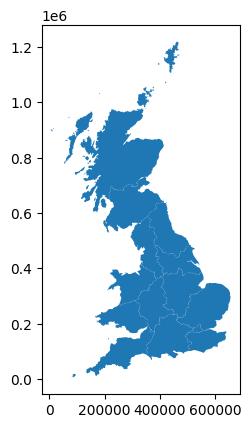

In [13]:
shape=gpd.read_file(file_path)
shape.plot()

In [14]:
file_path_in = '/content/drive/MyDrive/QEnergy/Data/Research/Maps/dno_license_areas_20200506/DNO_License_Areas_20200506.shp'

In [15]:
file_path_out = '/content/drive/MyDrive/QEnergy/Data/Research/Maps/dno_license_areas_20200506/DNO_License_Areas_20200506 (CORRECTED).json'

In [16]:
data = gpd.read_file(file_path_in)
# Now project coordinates to EPSG 4326:
data['geometry'] = data['geometry'].to_crs(epsg=4326)
data.to_file(file_path_out, driver="GeoJSON")

In [17]:
file_path_out = '/content/drive/MyDrive/QEnergy/Data/Research/Maps/dno_license_areas_20200506/DNO_License_Areas_20200506 (CORRECTED).json'

In [18]:
map_BMUs = folium.Map(location=[56, -0.5], zoom_start=6, tiles="cartodb positron")

folium.GeoJson(file_path_out).add_to(map_BMUs)

map_BMUs 

### Grid Boundaries map

In [19]:
%matplotlib inline
import matplotlib.pyplot as plt
import geopandas as gpd

<Axes: >

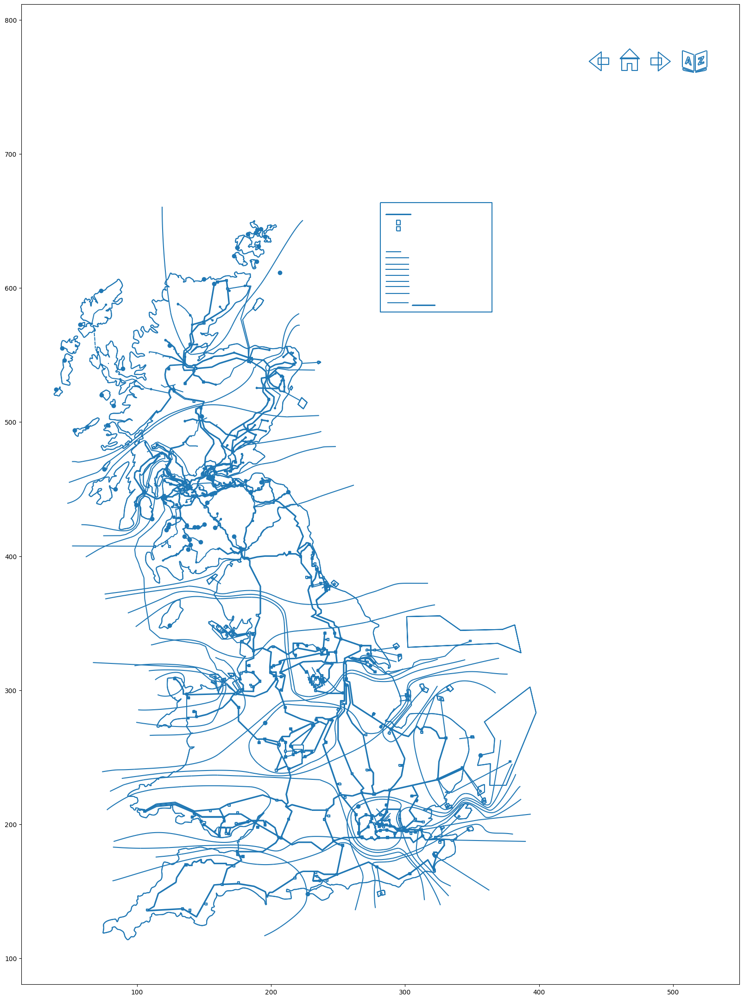

In [20]:
#open the DXF file
plano = gpd.read_file('/content/drive/MyDrive/QEnergy/Data/Research/Maps/Grid Boundaries/System_Zone_map.dxf')
plano.plot(figsize=(20,40))

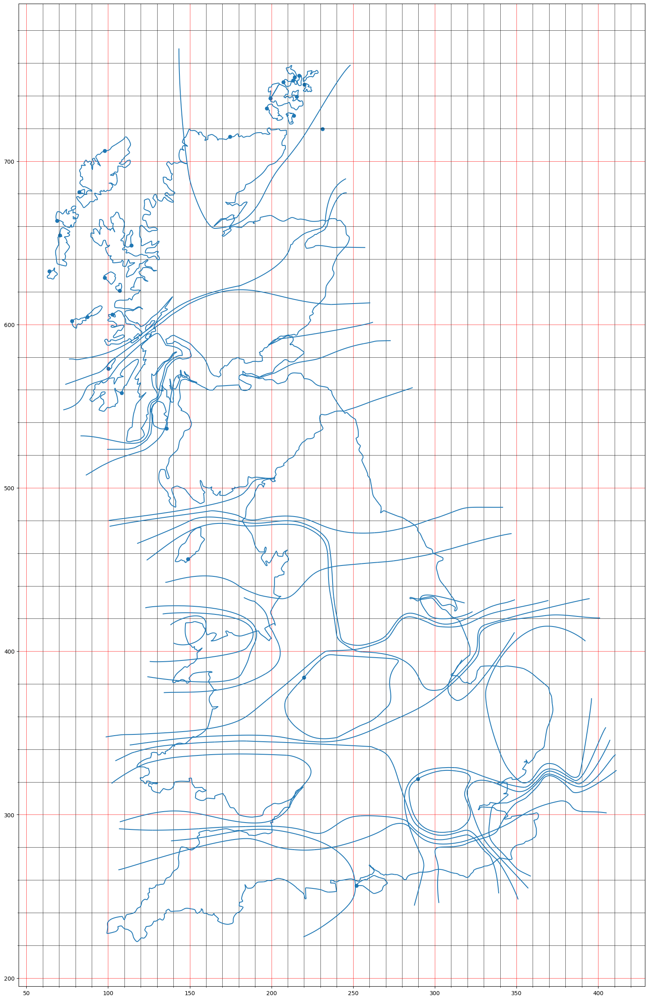

In [21]:
#open the DXF file
fig, ax = plt.subplots(figsize=(20,40))
plano = gpd.read_file('/content/drive/MyDrive/QEnergy/Data/Research/Maps/Grid Boundaries/System_Zone_map (BOUNDARIES).dxf')
plano.plot(figsize=(20,40), ax=ax)
ax.minorticks_on()
plt.grid(which='major', linewidth='0.5', color='red')
plt.grid(which='minor', linewidth='0.5', color='black')


In [22]:
# 150,720
# 58.627263, -4.997007

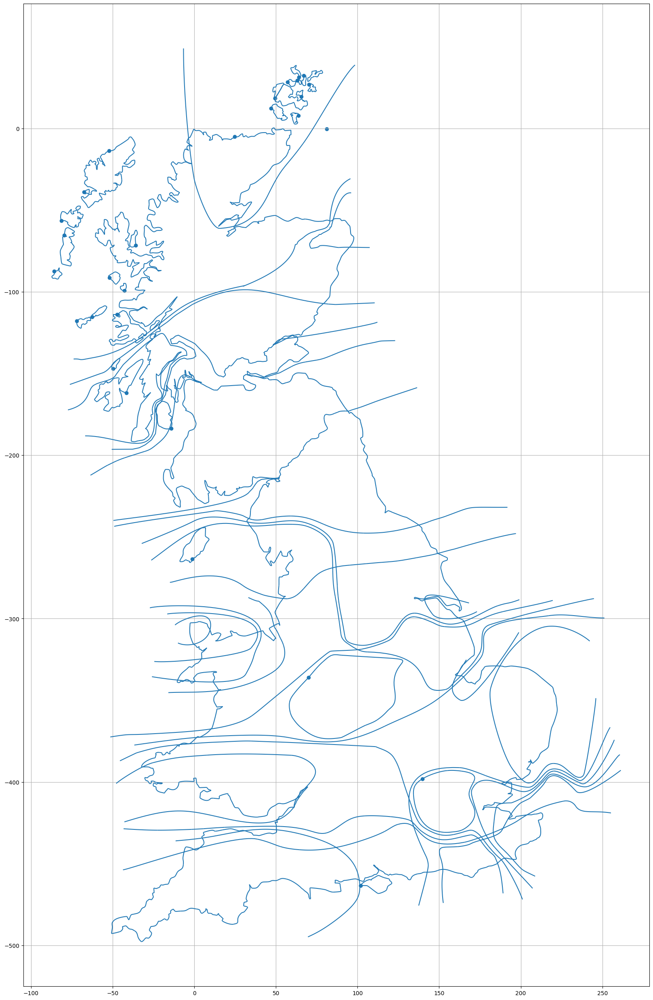

In [23]:
partialTranslation=plano.translate(-150,-720,0)
partialTranslation.plot(figsize=(20,40))
plt.grid()

In [24]:
# 20
#-4.693612 - (-4.419373) = 0.274239

# 400
# 58.627263 - 51.748187 = 6.879076

In [25]:
#scale_x = 0.274239/20
scale_x = 0.57/20
scale_y = 6.94/400

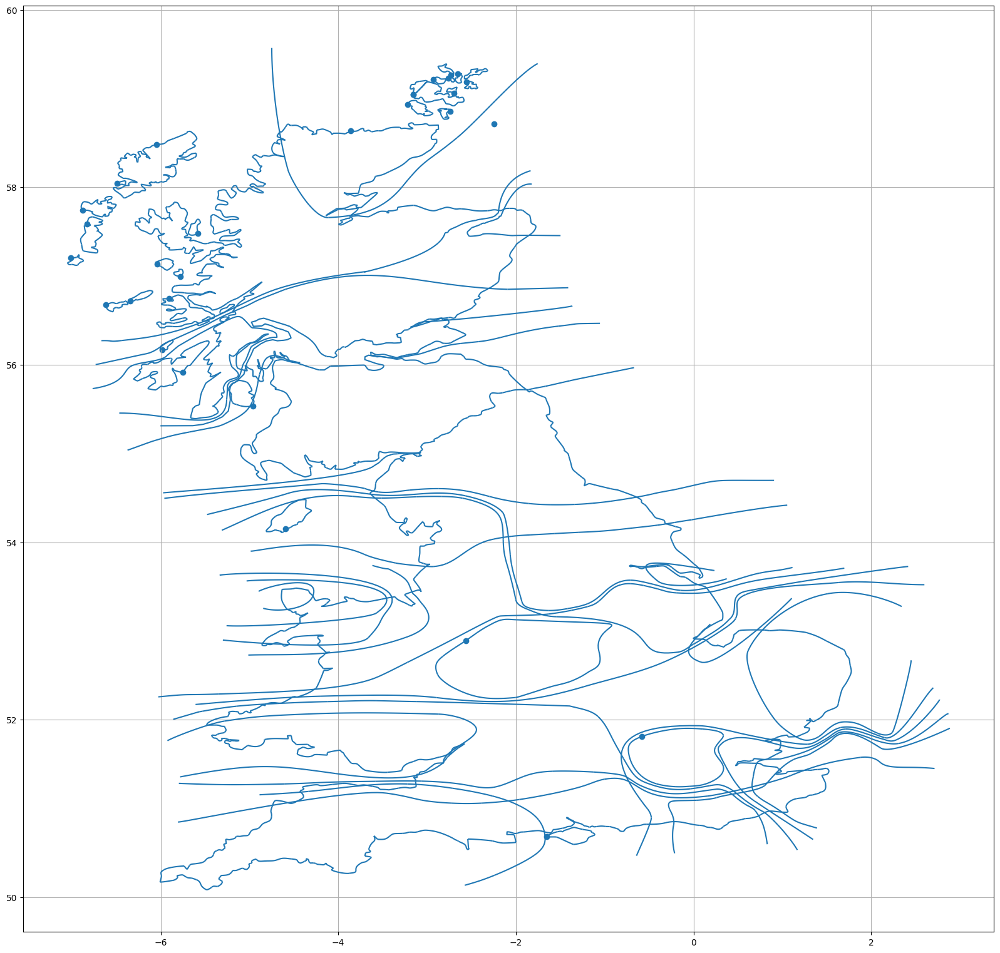

In [26]:
geometryScaled = partialTranslation.scale(scale_x, scale_y, 1, origin=(0,0,0)) #-261.75756,149.41021-261.66994,
geometryTranslated = geometryScaled.translate(-4.56, 58.72, 0) #30.24975, 99.84579
geometryRotated = geometryTranslated.rotate(0) 
geometryRotated.plot(figsize=(20,40))
plt.grid()

/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6


<Axes: >

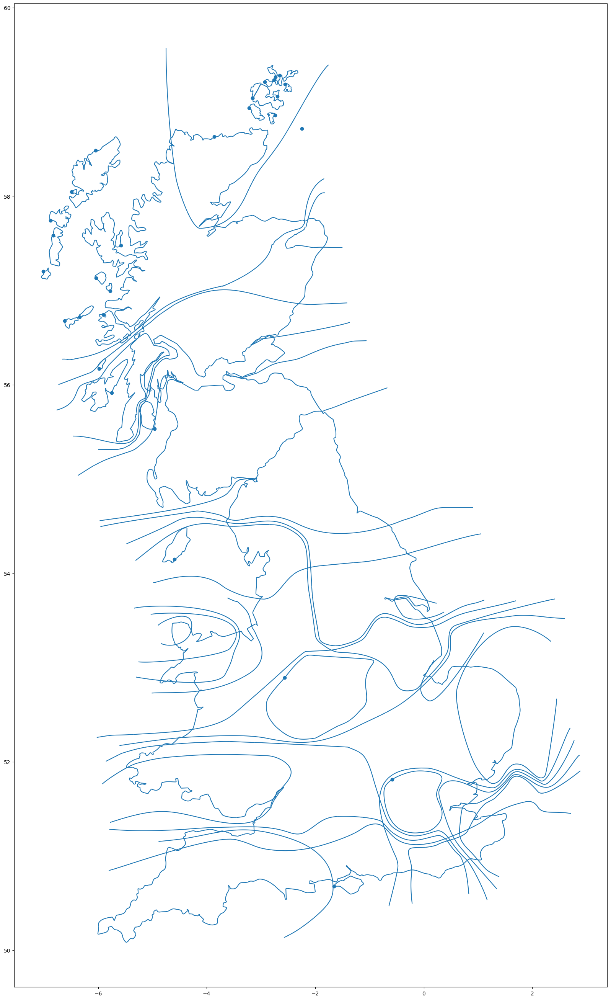

In [27]:
#apply the new geometry to the geopandas dataframe and apply the EPSG cpde
plano = gpd.GeoDataFrame(plano, geometry=geometryRotated)
plano.crs = {'init':'epsg:4277'}
plano.plot(figsize=(20,40))

In [28]:
#filter only the line elements
planoLines = plano[plano.geometry.type=='LineString']

In [29]:
#export the spatial as shapefile
planoLines.to_file('/content/drive/MyDrive/QEnergy/Data/Research/Maps/Grid Boundaries/System_Zone_map (BOUNDARIES).shp')

<ipython-input-29-26c2eab144be>:2: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.


In [30]:
file_path = '/content/drive/MyDrive/QEnergy/Data/Research/Maps/Grid Boundaries/System_Zone_map (BOUNDARIES).shp'

<Axes: >

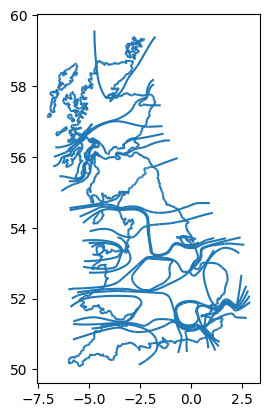

In [31]:
shape=gpd.read_file(file_path)
shape.plot()

In [32]:
file_path_in = '/content/drive/MyDrive/QEnergy/Data/Research/Maps/Grid Boundaries/System_Zone_map (BOUNDARIES).shp'

In [33]:
file_path_out = '/content/drive/MyDrive/QEnergy/Data/Research/Maps/Grid Boundaries/System_Zone_map (BOUNDARIES).json'

In [34]:
data = gpd.read_file(file_path_in)
# Now project coordinates to EPSG 4326:
data['geometry'] = data['geometry'].to_crs(epsg=4300)
data.to_file(file_path_out, driver="GeoJSON")

In [35]:
file_path_out = '/content/drive/MyDrive/QEnergy/Data/Research/Maps/Grid Boundaries/System_Zone_map (BOUNDARIES).json'

In [36]:
map_BMUs = folium.Map(location=[56, -0.5], zoom_start=6, tiles="cartodb positron")

folium.GeoJson(file_path_out).add_to(map_BMUs)

map_BMUs 

### Preparing BMUs 21-23 map

In [37]:
file_path_out1 = '/content/drive/MyDrive/QEnergy/Data/Research/Maps/dno_license_areas_20200506/DNO_License_Areas_20200506 (CORRECTED).json'

In [38]:
file_path_out2 = '/content/drive/MyDrive/QEnergy/Data/Research/Maps/Grid Boundaries/System_Zone_map (BOUNDARIES).json'

In [39]:
bmusid_21_23.head()

,BMU ID,BMU Name,BMU Fuel Type,BMU Party ID Comment,BMU GSP Group Name,LOC LAT,LOC LONG
0,E_GYAR-1,Great Yarmouth Power Limited,CCGT,INNOGY01,Eastern England,52.583834,1.733725
1,E_KLYN-A-1,Kings Lynn A,CCGT,INNOGY01,Eastern England,52.727436,0.380419
2,E_PETEM1,Peterborough,OCGT,CENPB,Eastern England,52.576835,-0.204150
3,T_COSO-1,Coryton Power Station,CCGT,CECL,Eastern England,51.512797,0.505550
4,T_LBAR-1,Little Barford main unit 1,CCGT,INNOGY01,Eastern England,52.203604,-0.269046


In [40]:
data = bmusid_21_23.copy()

In [41]:
map_BMUs = folium.Map(location=[56, -0.5], zoom_start=6, tiles="cartodb positron")

folium.GeoJson(file_path_out1).add_to(map_BMUs)


for i in range(0,len(data)):

  html = f'''BMU Name:  {data.iloc[i]['BMU Name']}<br>
  BMU ID:  {data.iloc[i]['BMU ID']}<br>
  Party ID:  {data.iloc[i]['BMU Party ID Comment']}<br>
  GSP Group:  {data.iloc[i]['BMU GSP Group Name']}<br>
  Fuel Type:  {data.iloc[i]['BMU Fuel Type']}'''

  iframe = folium.IFrame(html, width=325, height=125)

  popup_i = folium.Popup(iframe, max_width=325)
  
  folium.Marker(location=[data.iloc[i]['LOC LAT'], data.iloc[i]['LOC LONG']],
                popup=popup_i,).add_to(map_BMUs)

map_BMUs 

In [42]:
map_BMUs.save("/content/drive/MyDrive/QEnergy/Results/Maps/map_BMUs_21-23.html")

In [43]:
purpose_colour = {'COAL':'black', 'CCGT':'darkred', 'OCGT':'red','BATTERY':'purple', 
                  'NPSHYD':'darkblue', 'PS':'blue',
                  'BIOMASS':'darkgreen', 'WIND':'green', 'OTHER':'gray'}

In [44]:
'''
{'purple', 'white', 'red', 'blue', 'lightgray', 'darkred',
'lightblue', 'lightgreen', 'green', 'darkblue', 'orange', 'darkpurple',
 'darkgreen', 'beige', 'pink', 'lightred', 'black', 'cadetblue', 'gray'}
'''

"\n{'purple', 'white', 'red', 'blue', 'lightgray', 'darkred',\n'lightblue', 'lightgreen', 'green', 'darkblue', 'orange', 'darkpurple',\n 'darkgreen', 'beige', 'pink', 'lightred', 'black', 'cadetblue', 'gray'}\n"

In [45]:
data = bmusid_21_23.copy()

In [46]:
#data = data[data['BMU Fuel Type']=='COAL']
#data = data.reset_index(drop=True)

In [47]:
list(data['BMU Fuel Type'].unique())

['CCGT', 'OCGT', 'WIND', 'OTHER', 'BATTERY', 'COAL', 'NPSHYD', 'PS', 'BIOMASS']

In [48]:
#data.loc[[10,11,24,29,35,88,230,244,314],'BMU Fuel Type'].unique()

In [49]:
#data = data.loc[[10,11,24,29,35,88,230,244,314],:]
#data = data.reset_index(drop=True)

In [50]:
map_BMUs2 = folium.Map(location=[56, -0.5], zoom_start=6)#, tiles="cartodb positron")

folium.GeoJson(file_path_out1).add_to(map_BMUs2)


for i in range(0,len(data)):

  try:
    icon_color = purpose_colour[data.iloc[i]['BMU Fuel Type']]
  except:
    #Catch nans
    icon_color = 'gray'

  html = f'''BMU Name:  {data.iloc[i]['BMU Name']}<br>
  BMU ID:  {data.iloc[i]['BMU ID']}<br>
  Party ID:  {data.iloc[i]['BMU Party ID Comment']}<br>
  GSP Group:  {data.iloc[i]['BMU GSP Group Name']}<br>
  Fuel Type:  {data.iloc[i]['BMU Fuel Type']}'''

  iframe = folium.IFrame(html, width=325, height=125)

  popup_i = folium.Popup(iframe, max_width=325)
  
  folium.Marker(location=[data.iloc[i]['LOC LAT'], data.iloc[i]['LOC LONG']],
                popup=popup_i, icon=folium.Icon(color=icon_color, icon='')).add_to(map_BMUs2)

folium.LayerControl().add_to(map_BMUs2)

map_BMUs2 

In [51]:
map_BMUs2.save("/content/drive/MyDrive/QEnergy/Results/Maps/map_BMUs_21-23 (2).html")

In [52]:
data.head()

,BMU ID,BMU Name,BMU Fuel Type,BMU Party ID Comment,BMU GSP Group Name,LOC LAT,LOC LONG
0,E_GYAR-1,Great Yarmouth Power Limited,CCGT,INNOGY01,Eastern England,52.583834,1.733725
1,E_KLYN-A-1,Kings Lynn A,CCGT,INNOGY01,Eastern England,52.727436,0.380419
2,E_PETEM1,Peterborough,OCGT,CENPB,Eastern England,52.576835,-0.204150
3,T_COSO-1,Coryton Power Station,CCGT,CECL,Eastern England,51.512797,0.505550
4,T_LBAR-1,Little Barford main unit 1,CCGT,INNOGY01,Eastern England,52.203604,-0.269046


In [53]:
df = data[data['BMU Fuel Type']=='CCGT'].reset_index(drop=True)
df

,BMU ID,BMU Name,BMU Fuel Type,BMU Party ID Comment,BMU GSP Group Name,LOC LAT,LOC LONG
0,E_GYAR-1,Great Yarmouth Power Limited,CCGT,INNOGY01,Eastern England,52.583834,1.733725
1,E_KLYN-A-1,Kings Lynn A,CCGT,INNOGY01,Eastern England,52.727436,0.380419
2,T_COSO-1,Coryton Power Station,CCGT,CECL,Eastern England,51.512797,0.505550
3,T_LBAR-1,Little Barford main unit 1,CCGT,INNOGY01,Eastern England,52.203604,-0.269046
4,T_RYHPS-1,T_RYHPS-1,CCGT,SPGEN01,Eastern England,51.761793,0.008898
5,E_CORB-1,CORBY POWER LIMITED,CCGT,CORBY,East Midlands,52.510828,-0.681500
6,T_CDCL-1,T_CDCL-1,CCGT,EECL,East Midlands,53.307421,-0.786058
7,T_SPLN-1,Spalding Power Station,CCGT,SPAL,East Midlands,52.805849,-0.131242
8,T_STAY-1,Staythorpe Unit 1,CCGT,INNOGY01,East Midlands,53.075154,-0.856134
9,T_STAY-2,Staythorpe Unit 2,CCGT,INNOGY01,East Midlands,53.075154,-0.856134


In [54]:
cats_formats = {'COAL':['fire','black'], 'CCGT':['fire','darkred'], 'OCGT':['fire','red'],
                'BATTERY':['battery','purple'],
                'NPSHYD':['droplet','darkblue'], 'PS':['droplet','blue'], 
                'BIOMASS':['leaf','darkgreen'],
                'WIND':['wind','green'],
                'OTHER':['bolt','gray']}

In [55]:
cats = list(cats_formats.keys())
cats

['COAL', 'CCGT', 'OCGT', 'BATTERY', 'NPSHYD', 'PS', 'BIOMASS', 'WIND', 'OTHER']

In [56]:
base_map = folium.Map(location=[56, -0.5], zoom_start=6)#, tiles="cartodb positron")

folium.TileLayer('cartodb positron').add_to(base_map)
folium.GeoJson(file_path_out1).add_to(base_map)
folium.GeoJson(file_path_out2).add_to(base_map)


############################################################################################################
x = 'COAL'
df = data[data['BMU Fuel Type']==x].reset_index(drop=True)

ic = cats_formats[x][0]
col = cats_formats[x][1]
group1 = folium.FeatureGroup(name=x).add_to(base_map)

for i in range(0,len(df)):
    icon=folium.Icon(color=col, icon=ic, prefix= 'fa')

    html = f'''BMU Name:  {df.iloc[i]['BMU Name']}<br>
    BMU ID:  {df.iloc[i]['BMU ID']}<br>
    Party ID:  {df.iloc[i]['BMU Party ID Comment']}<br>
    GSP Group:  {df.iloc[i]['BMU GSP Group Name']}<br>
    Fuel Type:  {df.iloc[i]['BMU Fuel Type']}'''

    iframe = folium.IFrame(html, width=325, height=125)
    popup_i = folium.Popup(iframe, max_width=325)

    group1.add_child(folium.Marker(location=[df.iloc[i]['LOC LAT'], df.iloc[i]['LOC LONG']], icon=icon, popup=popup_i))


###############################################################
x = 'CCGT'
df = data[data['BMU Fuel Type']==x].reset_index(drop=True)

ic = cats_formats[x][0]
col = cats_formats[x][1]
group2 = folium.FeatureGroup(name=x).add_to(base_map)

for i in range(0,len(df)):
    icon=folium.Icon(color=col, icon=ic, prefix= 'fa')

    html = f'''BMU Name:  {df.iloc[i]['BMU Name']}<br>
    BMU ID:  {df.iloc[i]['BMU ID']}<br>
    Party ID:  {df.iloc[i]['BMU Party ID Comment']}<br>
    GSP Group:  {df.iloc[i]['BMU GSP Group Name']}<br>
    Fuel Type:  {df.iloc[i]['BMU Fuel Type']}'''

    iframe = folium.IFrame(html, width=325, height=125)
    popup_i = folium.Popup(iframe, max_width=325)

    group2.add_child(folium.Marker(location=[df.iloc[i]['LOC LAT'], df.iloc[i]['LOC LONG']], icon=icon, popup=popup_i))


###############################################################
x = 'OCGT'
df = data[data['BMU Fuel Type']==x].reset_index(drop=True)

ic = cats_formats[x][0]
col = cats_formats[x][1]
group3 = folium.FeatureGroup(name=x).add_to(base_map)

for i in range(0,len(df)):
    icon=folium.Icon(color=col, icon=ic, prefix= 'fa')

    html = f'''BMU Name:  {df.iloc[i]['BMU Name']}<br>
    BMU ID:  {df.iloc[i]['BMU ID']}<br>
    Party ID:  {df.iloc[i]['BMU Party ID Comment']}<br>
    GSP Group:  {df.iloc[i]['BMU GSP Group Name']}<br>
    Fuel Type:  {df.iloc[i]['BMU Fuel Type']}'''

    iframe = folium.IFrame(html, width=325, height=125)
    popup_i = folium.Popup(iframe, max_width=325)

    group3.add_child(folium.Marker(location=[df.iloc[i]['LOC LAT'], df.iloc[i]['LOC LONG']], icon=icon, popup=popup_i))


###############################################################
x = 'BATTERY'
df = data[data['BMU Fuel Type']==x].reset_index(drop=True)

ic = cats_formats[x][0]
col = cats_formats[x][1]
group4 = folium.FeatureGroup(name=x).add_to(base_map)

for i in range(0,len(df)):
    icon=folium.Icon(color=col, icon=ic, prefix='fa')

    html = f'''BMU Name:  {df.iloc[i]['BMU Name']}<br>
    BMU ID:  {df.iloc[i]['BMU ID']}<br>
    Party ID:  {df.iloc[i]['BMU Party ID Comment']}<br>
    GSP Group:  {df.iloc[i]['BMU GSP Group Name']}<br>
    Fuel Type:  {df.iloc[i]['BMU Fuel Type']}'''

    iframe = folium.IFrame(html, width=325, height=125)
    popup_i = folium.Popup(iframe, max_width=325)

    group4.add_child(folium.Marker(location=[df.iloc[i]['LOC LAT'], df.iloc[i]['LOC LONG']], icon=icon, popup=popup_i))


###############################################################
x = 'NPSHYD'
df = data[data['BMU Fuel Type']==x].reset_index(drop=True)

ic = cats_formats[x][0]
col = cats_formats[x][1]
group5 = folium.FeatureGroup(name=x).add_to(base_map)

for i in range(0,len(df)):
    icon=folium.Icon(color=col, icon=ic, prefix= 'fa')

    html = f'''BMU Name:  {df.iloc[i]['BMU Name']}<br>
    BMU ID:  {df.iloc[i]['BMU ID']}<br>
    Party ID:  {df.iloc[i]['BMU Party ID Comment']}<br>
    GSP Group:  {df.iloc[i]['BMU GSP Group Name']}<br>
    Fuel Type:  {df.iloc[i]['BMU Fuel Type']}'''

    iframe = folium.IFrame(html, width=325, height=125)
    popup_i = folium.Popup(iframe, max_width=325)

    group5.add_child(folium.Marker(location=[df.iloc[i]['LOC LAT'], df.iloc[i]['LOC LONG']], icon=icon, popup=popup_i))


###############################################################
x = 'PS'
df = data[data['BMU Fuel Type']==x].reset_index(drop=True)

ic = cats_formats[x][0]
col = cats_formats[x][1]
group6 = folium.FeatureGroup(name=x).add_to(base_map)

for i in range(0,len(df)):
    icon=folium.Icon(color=col, icon=ic, prefix= 'fa')

    html = f'''BMU Name:  {df.iloc[i]['BMU Name']}<br>
    BMU ID:  {df.iloc[i]['BMU ID']}<br>
    Party ID:  {df.iloc[i]['BMU Party ID Comment']}<br>
    GSP Group:  {df.iloc[i]['BMU GSP Group Name']}<br>
    Fuel Type:  {df.iloc[i]['BMU Fuel Type']}'''

    iframe = folium.IFrame(html, width=325, height=125)
    popup_i = folium.Popup(iframe, max_width=325)

    group6.add_child(folium.Marker(location=[df.iloc[i]['LOC LAT'], df.iloc[i]['LOC LONG']], icon=icon, popup=popup_i))


###############################################################
x = 'BIOMASS'
df = data[data['BMU Fuel Type']==x].reset_index(drop=True)

ic = cats_formats[x][0]
col = cats_formats[x][1]
group7 = folium.FeatureGroup(name=x).add_to(base_map)

for i in range(0,len(df)):
    icon=folium.Icon(color=col, icon=ic, prefix= 'fa')

    html = f'''BMU Name:  {df.iloc[i]['BMU Name']}<br>
    BMU ID:  {df.iloc[i]['BMU ID']}<br>
    Party ID:  {df.iloc[i]['BMU Party ID Comment']}<br>
    GSP Group:  {df.iloc[i]['BMU GSP Group Name']}<br>
    Fuel Type:  {df.iloc[i]['BMU Fuel Type']}'''

    iframe = folium.IFrame(html, width=325, height=125)
    popup_i = folium.Popup(iframe, max_width=325)

    group7.add_child(folium.Marker(location=[df.iloc[i]['LOC LAT'], df.iloc[i]['LOC LONG']], icon=icon, popup=popup_i))


###############################################################
x = 'WIND'
df = data[data['BMU Fuel Type']==x].reset_index(drop=True)

ic = cats_formats[x][0]
col = cats_formats[x][1]
group8 = folium.FeatureGroup(name=x).add_to(base_map)

for i in range(0,len(df)):
    icon=folium.Icon(color=col, icon=ic, prefix= 'fa')
    
    html = f'''BMU Name:  {df.iloc[i]['BMU Name']}<br>
    BMU ID:  {df.iloc[i]['BMU ID']}<br>
    Party ID:  {df.iloc[i]['BMU Party ID Comment']}<br>
    GSP Group:  {df.iloc[i]['BMU GSP Group Name']}<br>
    Fuel Type:  {df.iloc[i]['BMU Fuel Type']}'''

    iframe = folium.IFrame(html, width=325, height=125)
    popup_i = folium.Popup(iframe, max_width=325)
    group8.add_child(folium.Marker(location=[df.iloc[i]['LOC LAT'], df.iloc[i]['LOC LONG']], icon=icon, popup=popup_i))


###############################################################
x = 'OTHER'
df = data[data['BMU Fuel Type']==x].reset_index(drop=True)

ic = cats_formats[x][0]
col = cats_formats[x][1]
group9 = folium.FeatureGroup(name=x).add_to(base_map)

for i in range(0,len(df)):
    icon=folium.Icon(color=col, icon=ic, prefix= 'fa')

    html = f'''BMU Name:  {df.iloc[i]['BMU Name']}<br>
    BMU ID:  {df.iloc[i]['BMU ID']}<br>
    Party ID:  {df.iloc[i]['BMU Party ID Comment']}<br>
    GSP Group:  {df.iloc[i]['BMU GSP Group Name']}<br>
    Fuel Type:  {df.iloc[i]['BMU Fuel Type']}'''

    iframe = folium.IFrame(html, width=325, height=125)
    popup_i = folium.Popup(iframe, max_width=325)
    group9.add_child(folium.Marker(location=[df.iloc[i]['LOC LAT'], df.iloc[i]['LOC LONG']], icon=icon, popup=popup_i))



folium.LayerControl().add_to(base_map)

base_map 

In [57]:
base_map.save("/content/drive/MyDrive/QEnergy/Results/Maps/map_BMUs_21-23 (3).html")

### Preparing GRID map

In [ ]:
file_paths_in = ['/content/drive/MyDrive/QEnergy/Data/Research/Maps/Grid/CABLE.shp',
              '/content/drive/MyDrive/QEnergy/Data/Research/Maps/Grid/OHL.shp',
              '/content/drive/MyDrive/QEnergy/Data/Research/Maps/Grid/Substations.shp',
              '/content/drive/MyDrive/QEnergy/Data/Research/Maps/Grid/Towers.shp']

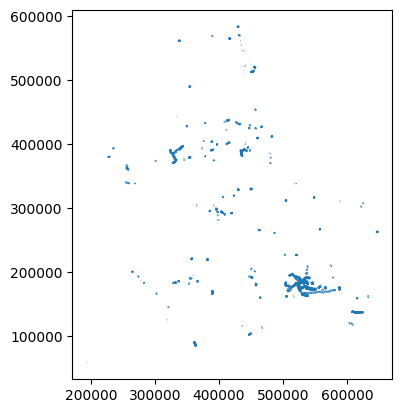

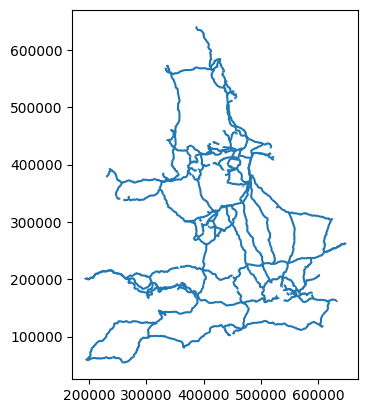

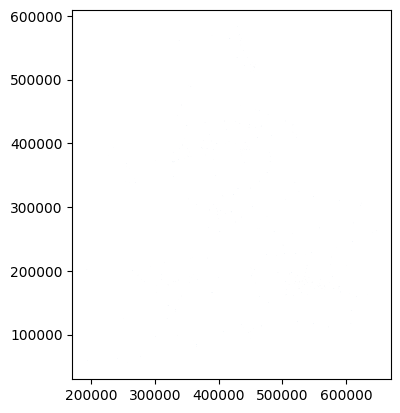

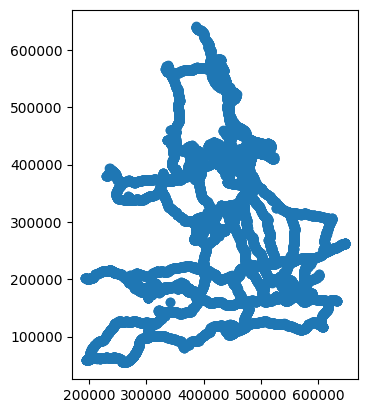

In [ ]:
for x in file_paths_in:
  shape=gpd.read_file(x)
  shape.plot()

In [ ]:
file_paths_out = []

for x in file_paths_in:

  file_path_in = x

  file_path_out = file_path_in.replace(".shp", " (CORRECTED).json")
  file_paths_out.append(file_path_out)

  data = gpd.read_file(file_path_in)
  # Now project coordinates to EPSG 4326:
  data['geometry'] = data['geometry'].to_crs(epsg=4326)
  data.to_file(file_path_out, driver="GeoJSON")


In [ ]:
file_paths_out

['/content/drive/MyDrive/QEnergy/Data/Research/Maps/Grid/CABLE (CORRECTED).json',
 '/content/drive/MyDrive/QEnergy/Data/Research/Maps/Grid/OHL (CORRECTED).json',
 '/content/drive/MyDrive/QEnergy/Data/Research/Maps/Grid/Substations (CORRECTED).json',
 '/content/drive/MyDrive/QEnergy/Data/Research/Maps/Grid/Towers (CORRECTED).json']

In [ ]:
file_paths_out[:3]

['/content/drive/MyDrive/QEnergy/Data/Research/Maps/Grid/CABLE (CORRECTED).json',
 '/content/drive/MyDrive/QEnergy/Data/Research/Maps/Grid/OHL (CORRECTED).json',
 '/content/drive/MyDrive/QEnergy/Data/Research/Maps/Grid/Substations (CORRECTED).json']

In [ ]:
map_GRID = folium.Map(location=[56, -0.5], zoom_start=6, tiles="cartodb positron")

for x in file_paths_out[:2]:
  folium.GeoJson(file_path_out).add_to(map_GRID)

map_GRID 

In [ ]:
map_GRID = folium.Map(location=[56, -0.5], zoom_start=6, tiles="cartodb positron")

folium.GeoJson(file_paths_out[3]).add_to(map_GRID)

map_GRID 

In [ ]:
map_GRID.save("/content/drive/MyDrive/QEnergy/Results/Maps/map_GRID.html")

In [ ]:
map_BMUs = folium.Map(location=[56, -0.5], zoom_start=6, tiles="cartodb positron")

folium.GeoJson(file_path_out).add_to(map_BMUs)


for i in range(0,len(data)):

  html = f'''BMU Name:  {data.iloc[i]['BMU Name']}<br>
  BMU ID:  {data.iloc[i]['BMU ID']}<br>
  Party ID:  {data.iloc[i]['BMU Party ID Comment']}<br>
  GSP Group:  {data.iloc[i]['BMU GSP Group Name']}<br>
  Fuel Type:  {data.iloc[i]['BMU Fuel Type']}'''

  iframe = folium.IFrame(html, width=325, height=125)

  popup_i = folium.Popup(iframe, max_width=325)
  
  folium.Marker(location=[data.iloc[i]['LOC LAT'], data.iloc[i]['LOC LONG']],
                popup=popup_i,).add_to(map_BMUs)

map_BMUs 

In [ ]:
map_BMUs.save("/content/drive/MyDrive/QEnergy/Results/map_BMUs_21-23.html")